<a href="https://colab.research.google.com/github/junjun2070/pic-16B-final-project/blob/main/PIC16B_Final_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Music Recommendation
##Introduction
The purpose of this topic is really straight forward, which we want to build a model that can help us to find and recommend music based on our own preference. And also, by understanding the logic and intuition behind the model, we might help the artist to understand how the music evolve overtime and maybe help them to fit within a broader music landscape. The question that we want to answers are why are some music recommendation app bad? How can we build a music recommendation system based on the data we have? What are some hidden relationships between music that indicates user’s
preferences? Where can we find these relationship?


Music recommendation systems use algorithms and data analysis to suggest songs to listeners based on their preferences and listening history. These systems analyze various factors, such as user behavior, song characteristics, and collaborative filtering, to predict what music a user might enjoy. By leveraging machine learning techniques, they can identify patterns and similarities between songs and users, providing personalized playlists and discovering new music. Popular examples include Spotify's Discover Weekly and Apple's For You playlists. The goal is to enhance user experience by introducing listeners to new tracks that align with their tastes, thus keeping them engaged and satisfied.



# Importing Packages & Data
First, let's obtain the spotify song dataset.

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import os
import plotly.express as px
import numpy as np
# for training model:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.manifold import TSNE # for visualization
# song recommendation import
from collections import defaultdict # creating dicts with default values
# from sklearn.metrics import euclidean_distances # calculating distances between vectors
from scipy.spatial.distance import cdist # computing distances between vecots in cosine
# import difflib # string comparison functionalities
from sklearn.cluster import KMeans
from sklearn.pipeline import Pipeline # chain together multiple steps in machine learning wrokflow
from plotly.subplots import make_subplots
import plotly.graph_objects as go


In [2]:
# Load the datasets
data = pd.read_csv('https://raw.githubusercontent.com/junjun2070/pic-16B-final-project/main/data.csv')
data_by_artist = pd.read_csv('https://raw.githubusercontent.com/junjun2070/pic-16B-final-project/main/data_by_artist.csv')
data_by_genres = pd.read_csv('https://raw.githubusercontent.com/junjun2070/pic-16B-final-project/main/data_by_genres.csv')
data_by_year = pd.read_csv('https://raw.githubusercontent.com/junjun2070/pic-16B-final-project/main/data_by_year.csv')
data_w_genres = pd.read_csv('https://raw.githubusercontent.com/junjun2070/pic-16B-final-project/main/data_w_genres.csv')


# Data Vitualization and Explanation

Let's look at "data" dataset.

In [4]:
data

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.98200,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.6650,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.73200,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.1600,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.96100,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.1010,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.96700,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.3810,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.95700,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.2290,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
170648,0.6080,2020,0.08460,"['Anuel AA', 'Daddy Yankee', 'KAROL G', 'Ozuna...",0.786,301714,0.808,0,0KkIkfsLEJbrcIhYsCL7L5,0.000289,7,0.0822,-3.702,1,China,72,2020-05-29,0.0881,105.029
170649,0.7340,2020,0.20600,['Ashnikko'],0.717,150654,0.753,0,0OStKKAuXlxA0fMH54Qs6E,0.000000,7,0.1010,-6.020,1,Halloweenie III: Seven Days,68,2020-10-23,0.0605,137.936
170650,0.6370,2020,0.10100,['MAMAMOO'],0.634,211280,0.858,0,4BZXVFYCb76Q0Klojq4piV,0.000009,4,0.2580,-2.226,0,AYA,76,2020-11-03,0.0809,91.688
170651,0.1950,2020,0.00998,['Eminem'],0.671,337147,0.623,1,5SiZJoLXp3WOl3J4C8IK0d,0.000008,2,0.6430,-7.161,1,Darkness,70,2020-01-17,0.3080,75.055


Inside the "data" dataset, we have more than 170,000 rows and in total 19 columns with the id of the music, year and multiple features about the music, including valence, acousticness, etc.

In [5]:
print(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [6]:
data.describe() # some statistical properties of the numerical columns

,valence,year,acousticness,danceability,duration_ms,energy,explicit,instrumentalness,key,liveness,loudness,mode,popularity,speechiness,tempo
count,170653.000000,170653.000000,170653.000000,170653.000000,1.706530e+05,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000
mean,0.528587,1976.787241,0.502115,0.537396,2.309483e+05,0.482389,0.084575,0.167010,5.199844,0.205839,-11.467990,0.706902,31.431794,0.098393,116.861590
std,0.263171,25.917853,0.376032,0.176138,1.261184e+05,0.267646,0.278249,0.313475,3.515094,0.174805,5.697943,0.455184,21.826615,0.162740,30.708533
min,0.000000,1921.000000,0.000000,0.000000,5.108000e+03,0.000000,0.000000,0.000000,0.000000,0.000000,-60.000000,0.000000,0.000000,0.000000,0.000000
25%,0.317000,1956.000000,0.102000,0.415000,1.698270e+05,0.255000,0.000000,0.000000,2.000000,0.098800,-14.615000,0.000000,11.000000,0.034900,93.421000
50%,0.540000,1977.000000,0.516000,0.548000,2.074670e+05,0.471000,0.000000,0.000216,5.000000,0.136000,-10.580000,1.000000,33.000000,0.045000,114.729000
75%,0.747000,1999.000000,0.893000,0.668000,2.624000e+05,0.703000,0.000000,0.102000,8.000000,0.261000,-7.183000,1.000000,48.000000,0.075600,135.537000
max,1.000000,2020.000000,0.996000,0.988000,5.403500e+06,1.000000,1.000000,1.000000,11.000000,1.000000,3.855000,1.000000,100.000000,0.970000,243.507000


Let's vitualize each features!

These are the nine main features we use throughtout our model. Each FEATURE can be a good representation of a song's characteristics. And let's look at the definition of each features.

"Valence" describes the musical positivity conveyed by a piece of music. HIGH valence represents positive and happiness, while LOW valence means negative and sadness.

"Acousticness" measures the whether the track is acoustic, with 1 represents high confidence the track is acoustic. In the opposite is the track is electronic.

"Danceability" is measured using a mixture of song features such as beat strength, tempo stability, and overall tempo.

"Energy" in music is a perceptible measure of intensity and activity.

"Instrumentalness" predicts whether a track contains vocals.

“Liveness” refers directly to reverberation time.

"Loudness" is the attribute of a sound that determines the magnitude of the auditory sensation produced and that primarily depends on the amplitude of the sound wave involved

"Speechiness" detects the presence of spoken words in a track

"Tempo" is the number of beats per minute

In [7]:
fig=make_subplots(rows=3,cols=3,subplot_titles=('<i>valence', '<i>danceability', '<i>energy', '<i>loudness', '<i>speechiness', '<i>acousticness', '<i>liveness', '<i>instrumentalness', '<i>tempo'))
fig.add_trace(go.Histogram(x=data['valence'],name='valence'),row=1,col=1)
fig.add_trace(go.Histogram(x=data['danceability'],name='danceability'),row=1,col=2)
fig.add_trace(go.Histogram(x=data['energy'],name='energy'),row=1,col=3)
fig.add_trace(go.Histogram(x=data['loudness'],name='loudness'),row=2,col=1)
fig.add_trace(go.Histogram(x=data['speechiness'],name='speechiness'),row=2,col=2)
fig.add_trace(go.Histogram(x=data['acousticness'],name='acousticness'),row=2,col=3)
fig.add_trace(go.Histogram(x=data['liveness'],name='liveness'),row=3,col=1)
fig.add_trace(go.Histogram(x=data['instrumentalness'],name='instrumentalness'),row=3,col=2)
fig.add_trace(go.Histogram(x=data['tempo'],name='tempo'),row=3,col=3)
fig.update_layout(height=900,width=900,title_text='<b>Feature Distribution')
fig.update_layout(template='plotly_dark',title_x=0.5)

Here, we have used the dataset of data_by_genre to draw this graph. Due to the large number of data, about 3000, we randomly selected 20 datas as a demonstration to make the icon look less confusing. From the picture we can see that the features of each genre are very different, some acousticness is close to 1 but other features are close to 0.2, some are just the opposite. This proves that each genre has its own unique feature data. Possibly, we can analyze each person's preference and make music recommendation by each genre's feature.

In [8]:
main_features = ['valence', 'acousticness','danceability', 'energy']

data_by_genre_sample = data_by_genres.sample(n=20)
my_data = data_by_genre_sample.head(20)

fig = px.line(my_data, x = 'genres', y = main_features)
fig.show()

In our data, popularity tells us very efficiently how popular each song is. As you can see from this icon, most of the songs are clustered in the popularity range of 0 to 60.



<Axes: xlabel='new_popularity', ylabel='Count'>

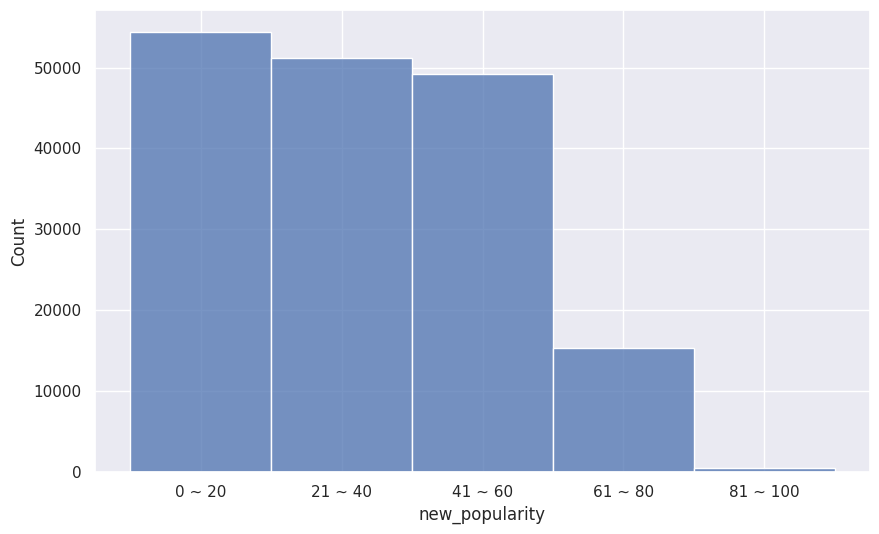

In [9]:
# In this dataset, popularity is ranked from 0 to 100, with 0 being unpopular and 100 being the most popular.
data['popularity'].unique()

def get_popularity(x):
    new_pop = ''
    if 0 <= x <= 20:
        new_pop = '0 ~ 20'
    elif 20 < x <= 40:
        new_pop = '21 ~ 40'
    elif 40 < x <= 60:
        new_pop = '41 ~ 60'
    elif 60 < x <= 80:
        new_pop = '61 ~ 80'
    elif 80 < x <= 100:
        new_pop = '81 ~ 100'
    return new_pop

data['new_popularity'] = data['popularity'].apply(get_popularity)
data['new_popularity'] = pd.Categorical(data['new_popularity'], ['0 ~ 20','21 ~ 40','41 ~ 60','61 ~ 80','81 ~ 100'])
sns.set(rc={'figure.figsize':(10 ,6)})
sns.histplot(data['new_popularity'])

In [10]:
data1 = data[['valence','new_popularity']]
data1.groupby('new_popularity').describe()

valence                                                     
                  count      mean       std  min    25%    50%    75%    max
new_popularity                                                              
0 ~ 20          54404.0  0.508824  0.268190  0.0  0.285  0.527  0.730  1.000
21 ~ 40         51160.0  0.555779  0.262470  0.0  0.347  0.572  0.779  0.998
41 ~ 60         49189.0  0.529728  0.261586  0.0  0.319  0.533  0.747  1.000
61 ~ 80         15351.0  0.505544  0.244676  0.0  0.316  0.503  0.702  0.991
81 ~ 100          549.0  0.495195  0.230968  0.0  0.323  0.492  0.668  0.969

# Correlation Matrix

Now, we create the correlation matrix to explore the relationship between the features.

                   valence      year  acousticness  danceability  duration_ms  \
valence           1.000000 -0.028245     -0.184101      0.558946    -0.191813   
year             -0.028245  1.000000     -0.614250      0.188515     0.079713   
acousticness     -0.184101 -0.614250      1.000000     -0.266852    -0.076373   
danceability      0.558946  0.188515     -0.266852      1.000000    -0.139937   
duration_ms      -0.191813  0.079713     -0.076373     -0.139937     1.000000   
energy            0.353876  0.530272     -0.749393      0.221967     0.042119   
explicit         -0.018613  0.220881     -0.246007      0.241757    -0.048880   
instrumentalness -0.198501 -0.272371      0.329819     -0.278063     0.084770   
key               0.028473  0.007540     -0.020550      0.024439    -0.004266   
liveness          0.003832 -0.057318     -0.024482     -0.100193     0.047168   
loudness          0.313512  0.487697     -0.561696      0.285057    -0.003037   
mode              0.015641 -

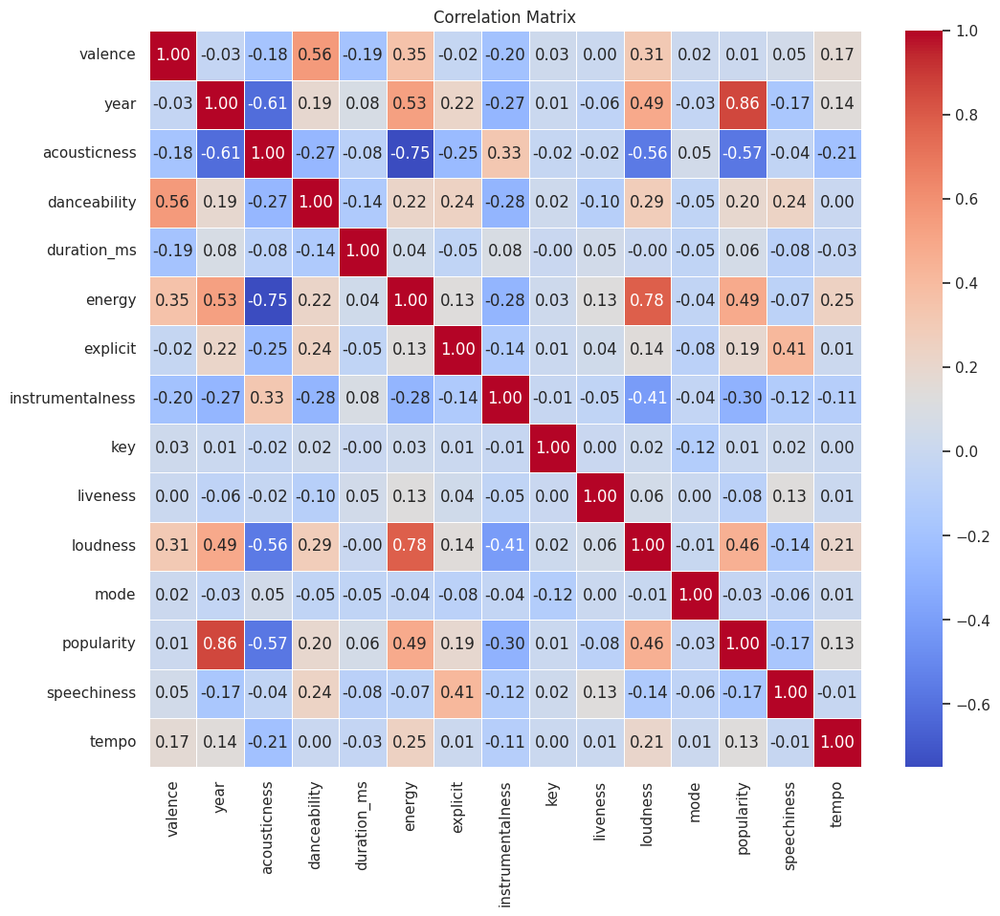

In [11]:
# Select only numeric columns
numeric_data = data.select_dtypes(include='number')

# Compute the correlation matrix
correlation_matrix = numeric_data.corr()

# Display the correlation matrix
print(correlation_matrix)

# Visualize the correlation matrix
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title('Correlation Matrix')
plt.show()

We observed that there is a strong positive correlation between year and popularity, which is 0.86, indicating that more recent years have higher popularity scores. And the correlation between energy and loudness is 0.78, indicating that as the energy of a song increases, loudness tends to increase as well. Besides, there is also a positive correlation between danceability and valence, which is 0.56, showing that more danceable tracks tend to have a higher valence. In contrast, the correlation between acousticness with energy and year are negative, which are -0.71 and -0.61, suggesting that more acoustic tracks tend to be quieter and less energetic. We also observed that there are some features having no correlation (0.00) with each other, such as valence and liveness, danceability and tempo.

In [12]:
new_data = data.sample(n=10000)
px.scatter(new_data,x='year',y='popularity',color='year',color_continuous_scale=px.colors.sequential.Plasma,template='plotly_dark',title='<b> Year versus Popularity')

This plot indicates that more recent years have higher popularity scores.

In [13]:
px.scatter(new_data,x='energy',y='loudness',color='energy',color_continuous_scale=px.colors.sequential.Plasma,template='plotly_dark',title='<b> Energy versus Loudness')

This plot indicates that as the energy of a song increases, loudness tends to increase as well.

In [14]:
px.scatter(data,x='acousticness',y='energy',color='acousticness',color_continuous_scale=px.colors.sequential.Plasma,template='plotly_dark',title='<b> Acousticness versus Energy')

The data points appear to be spread across the entire range of both acousticness and energy, showing that there is little negative correlation between the features,

# PCA

We then use pca to explore the dimension reduction and explained variance of the features.

In [15]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

             PC1       PC2       PC3       PC4       PC5       PC6       PC7  \
0       4.282668  2.295402  1.761012  3.326086  1.164322  2.380347  0.066842   
1       1.393690 -3.515663 -0.614123 -0.399072  0.074618  1.705827 -0.683668   
2       3.852971  1.734295  0.408367  0.524437 -0.254556  0.406444  1.440319   
3       2.538965  0.304841 -0.215672  1.513418 -0.685244  0.154988 -1.187538   
4       2.551295 -0.275455 -0.580249  0.442537 -0.994640  0.132456 -0.602359   
...          ...       ...       ...       ...       ...       ...       ...   
170648 -3.263871  0.572884 -0.176829 -1.086840  0.041414  0.840131 -0.487809   
170649 -2.968665  0.167864 -0.855463 -0.983445 -0.077959 -0.520419 -0.575080   
170650 -3.309009  0.673825  0.323280 -0.387761  0.715022  1.147838  0.108725   
170651 -2.741518 -0.216925  3.992110  0.987947 -2.014634  1.426451 -0.634175   
170652 -3.635730 -1.013555  1.827258 -1.447413 -0.596190  0.375071 -0.760069   

             PC8       PC9      PC10   

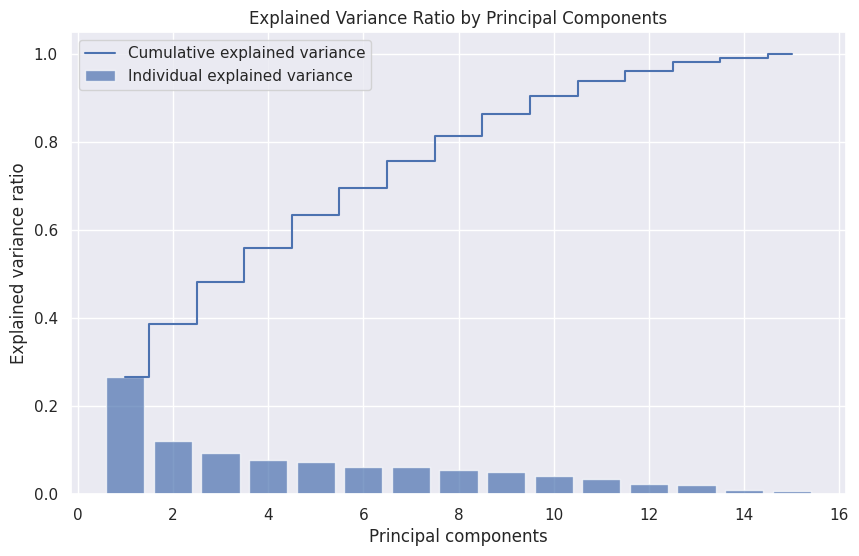


Top features contributing to PC1:
acousticness        0.414657
instrumentalness    0.256982
mode                0.024533
speechiness         0.013481
duration_ms        -0.001702
Name: PC1, dtype: float64

Top features contributing to PC2:
duration_ms         0.316831
year                0.281626
popularity          0.265095
instrumentalness    0.177408
energy              0.046579
Name: PC2, dtype: float64

Top features contributing to PC3:
explicit       0.559150
speechiness    0.444336
duration_ms    0.202180
year           0.178805
popularity     0.149035
Name: PC3, dtype: float64

Top features contributing to PC4:
liveness       0.751302
tempo          0.279032
energy         0.250468
duration_ms    0.237334
loudness       0.144676
Name: PC4, dtype: float64

Top features contributing to PC5:
key                 0.675154
instrumentalness    0.166598
duration_ms         0.136112
valence             0.125634
energy              0.068848
Name: PC5, dtype: float64

Top features contri

In [16]:
# Standardize the data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(numeric_data)

# Perform PCA
pca = PCA()
pca_components = pca.fit_transform(scaled_data)

# Create a DataFrame with the PCA components
pca_data = pd.DataFrame(pca_components, columns=[f'PC{i+1}' for i in range(pca_components.shape[1])])

# Explained variance ratio
explained_variance = pca.explained_variance_ratio_

# Display the PCA components and plot the explained variance ratio
print(pca_data)

plt.figure(figsize=(10, 6))
plt.bar(range(1, len(explained_variance) + 1), explained_variance, alpha=0.7, align='center', label='Individual explained variance')
plt.step(range(1, len(explained_variance) + 1), explained_variance.cumsum(), where='mid', label='Cumulative explained variance')
plt.ylabel('Explained variance ratio')
plt.xlabel('Principal components')
plt.legend(loc='best')
plt.title('Explained Variance Ratio by Principal Components')
plt.show()

# Get the loadings
loadings = pd.DataFrame(pca.components_.T, columns=[f'PC{i+1}' for i in range(pca.components_.shape[0])], index=numeric_data.columns)

# Display the top 5 contributing features for each PC
for i in range(loadings.shape[1]):
    print(f"\nTop features contributing to PC{i+1}:")
    print(loadings.iloc[:, i].sort_values(ascending=False).head())

 From the explained variance plot, we observed that PC1 captures approximately 0.27 of the explained variance, and PC2 contributes to approximately 0.12 of the explained variance. For each PC, we can observe the contribution from each feature to the component. For example, acousticness contributes to PC1 the most and duration contributes to PC2 the most.

# Random Forest

In [17]:


labelecoder_data = data.copy()
le = LabelEncoder()

labelecoder_data['new_popularity'] = le.fit_transform(labelecoder_data['new_popularity'])

X = labelecoder_data[['valence', 'acousticness', 'danceability', 'energy']]
y = labelecoder_data['new_popularity']

X_train, X_test, y_train, y_test = train_test_split(X,y, test_size = 0.3, random_state = 42)

# create RF model
rf = RandomForestClassifier(max_depth = None, max_features = 3,
                             min_samples_leaf = 2, min_samples_split = 3,
                             n_estimators = 200)

# fit model
rf.fit(X_train, y_train)

from sklearn.metrics import accuracy_score
print(f'Accuracy on train datas: {rf.score(X_train, y_train)}')
y_pred = rf.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy on test datas: {accuracy}")

y_test_proba = rf.predict_proba(X_test)
y_test_proba

Accuracy on train datas: 0.9736306788216681
Accuracy on test datas: 0.534573013516681


array([[0.17483333, 0.25640476, 0.54269048, 0.02232143, 0.00375   ],
       [0.67945833, 0.19779167, 0.11566667, 0.00708333, 0.        ],
       [0.01333333, 0.39358333, 0.44191667, 0.14866667, 0.0025    ],
       ...,
       [0.63516667, 0.24108333, 0.10333333, 0.02041667, 0.        ],
       [0.22165476, 0.51491667, 0.20584524, 0.05758333, 0.        ],
       [0.21072619, 0.39030952, 0.29740476, 0.10155952, 0.        ]])

Here is an example of the classification model we did using the data 'valence', 'acousticsness', 'danceability', 'energy' as X inputs and 'new_popularity' as output. We can see there is a overfitting happenning. And there is a overfitting problem for all of the classification models. This might be the case that there is high correlation between each features, causing the model to overemphaize the relationtions. And more importantly, there is a unbalanced data. For our output data 'new_popularity', most of the data are skewed to the left, and only a tiny protion of the data were considered popular. So the model might failed to correctly adjust the minority class.

And so that's why we started to try clustering.

# Unsupervised Learning: music recommendation using clustering


## K-Means Clustering


---

Divide the genres in this dataset into clusters based on the numeric features of each songs

There are 2973 genres in the data by genres dataset, now let's see the relationships between these genres

In [18]:
# perform simple kmeans cluster to data entered
def simple_kmeans(n_clusters, data):
  """
    This function applies k-means clustering on the numerical features of the input dataset.
    It standardizes the data before clustering and appends the cluster labels to the dataset.

    Parameters:
    n_clusters (int): The number of clusters to form.
    data (pd.DataFrame): The input dataset containing numerical and non-numerical features.

    Returns:
    pd.DataFrame: The input dataset with an additional column 'cluster' containing the cluster labels.
  """
  cluster_pipeline = Pipeline([
      ('scaler', StandardScaler()), # standardization
      ('kmeans', KMeans(n_clusters=n_clusters)) # simple K-means clustering, let's say 20 clusters
      # ('kmeans',KMeans(n_cluster = 10,n_jobs=-1))
      ]) # tuples ('step_name',step)

  num_data = data.select_dtypes(np.number) # select the numerical columns
  cluster_pipeline.fit(num_data) # fit the data

  data['cluster'] = cluster_pipeline.predict(num_data) # predict the cluster for each genre
  return data


Visualizing class: create a class to handle visualization, manage different types of plots and their parameters


In [19]:

class Visualization:
    def __init__(self, data):
        """
        Initialize the Visualization with the dataset.

        Parameters:
        data (pd.DataFrame): The dataset to visualize.
        """
        self.data = data
    # visualizing clusters with t-SNE
    # t-SNE (t-distributed stochastic neighbor embedding) is a machine learnign algorithm
    # used for dimensionality reduction, particularly well-suited for visualizing high-di-
    # mentional data in a lower-dimensional space (2d or 3d), it calculates pairwise distances between datapoints
    # in high dimentional space, and converts them to probability distribution.
    def tsne_plot(self, title):
        """Perform t-SNE dimensionality reduction and plot the results in 2D."""
        tsne_pipeline = Pipeline([
            ('scaler', StandardScaler()),
            ('tsne', TSNE(n_components=2, verbose=1))
        ])
        num_data = self.data.select_dtypes(np.number)
        embedding = tsne_pipeline.fit_transform(num_data)
        projection = pd.DataFrame(columns=['x', 'y'], data=embedding)
        projection[title] = self.data[title].values
        projection['cluster'] = self.data['cluster'].values
        fig = px.scatter(projection, x='x', y='y', color='cluster', hover_data=['x', 'y', title],
                         title=f'Visualization of Music of {title} in {self.data["cluster"].nunique()} Clusters')
        return fig



In [20]:
data_by_genres

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,21st century classical,0.979333,0.162883,1.602977e+05,0.071317,0.606834,0.361600,-31.514333,0.040567,75.336500,0.103783,27.833333,6
1,1,432hz,0.494780,0.299333,1.048887e+06,0.450678,0.477762,0.131000,-16.854000,0.076817,120.285667,0.221750,52.500000,5
2,1,8-bit,0.762000,0.712000,1.151770e+05,0.818000,0.876000,0.126000,-9.180000,0.047000,133.444000,0.975000,48.000000,7
3,1,[],0.651417,0.529093,2.328809e+05,0.419146,0.205309,0.218696,-12.288965,0.107872,112.857352,0.513604,20.859882,7
4,1,a cappella,0.676557,0.538961,1.906285e+05,0.316434,0.003003,0.172254,-12.479387,0.082851,112.110362,0.448249,45.820071,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2968,1,zolo,0.222625,0.547082,2.580991e+05,0.610240,0.143872,0.204206,-11.295878,0.061088,125.494919,0.596155,33.778943,9
2969,0,zouglou,0.161000,0.863000,2.063200e+05,0.909000,0.000000,0.108000,-5.985000,0.081300,119.038000,0.845000,58.000000,7
2970,1,zouk,0.263261,0.748889,3.060728e+05,0.622444,0.257227,0.089678,-10.289222,0.038778,101.965222,0.824111,46.666667,5
2971,0,zurich indie,0.993000,0.705667,1.984173e+05,0.172667,0.468633,0.179667,-11.453333,0.348667,91.278000,0.739000,0.000000,7


In [21]:
genre_data = simple_kmeans(25, data_by_genres) # cluster genere data
# plot the cluster of genres, visualizign the relationships between clusters of generes
# fig = simple_tsne_plot(genre_data, 'genres')
visualization_genre = Visualization(genre_data)
visualization_genre.tsne_plot('genres')
# Save the figure as an HTML file

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.005s...
[t-SNE] Computed neighbors for 2973 samples in 0.351s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.838102
[t-SNE] KL divergence after 250 iterations with early exaggeration: 69.555702
[t-SNE] KL divergence after 1000 iterations: 1.050858


The result shows that the close genres are clustered together, for example, classic greek pop, sudanese pop, and classic russian pop are closely clustered in cluster 5; kpop, japanese electropop, and girl group are clustered close together in cluster 18. It also clusters norwegian death metal, gernal metal, spanish metal, japanese heavy metal together in cluster 21. It indicates some shared features between these genres.

In [22]:
year_data = simple_kmeans(10, data_by_year) # cluster year data
# showing clusters of music of different years
visualization_year = Visualization(year_data)
visualization_year.tsne_plot('year')

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 100 samples in 0.000s...
[t-SNE] Computed neighbors for 100 samples in 0.006s...
[t-SNE] Computed conditional probabilities for sample 100 / 100
[t-SNE] Mean sigma: 2.149044
[t-SNE] KL divergence after 250 iterations with early exaggeration: 49.179543
[t-SNE] KL divergence after 950 iterations: 0.085548


It shows that music close in years are clusted together

In [23]:
# now cluster artists data:
# get a subset of artists
all_artists = data['artists'].unique()
artist_sample = np.random.choice(all_artists, 30)
artist_data = data[data['artists'].isin(artist_sample)]
# cluster artist data
artist_data = simple_kmeans(30, artist_data)
artist_data.info()
# visualize relationships between clusters of artists' music

visualization_artist = Visualization(artist_data)
visualization_artist.tsne_plot('artists')


<class 'pandas.core.frame.DataFrame'>
Index: 143 entries, 5585 to 170610
Data columns (total 21 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   valence           143 non-null    float64 
 1   year              143 non-null    int64   
 2   acousticness      143 non-null    float64 
 3   artists           143 non-null    object  
 4   danceability      143 non-null    float64 
 5   duration_ms       143 non-null    int64   
 6   energy            143 non-null    float64 
 7   explicit          143 non-null    int64   
 8   id                143 non-null    object  
 9   instrumentalness  143 non-null    float64 
 10  key               143 non-null    int64   
 11  liveness          143 non-null    float64 
 12  loudness          143 non-null    float64 
 13  mode              143 non-null    int64   
 14  name              143 non-null    object  
 15  popularity        143 non-null    int64   
 16  release_date      143 non

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

<ipython-input-18-de4a2a46b0ec>:23: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[t-SNE] Computed neighbors for 143 samples in 0.008s...
[t-SNE] Computed conditional probabilities for sample 143 / 143
[t-SNE] Mean sigma: 2.096510
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.210411
[t-SNE] KL divergence after 1000 iterations: 0.426458


It shows that music of the same artist is (mostly) clustered together, but different artists' music can also be clustered together, suggesting they share some qualities.
All the results above suggest that music with similar features might be close in vector space and clusterd together.

## Clustering alll music with K-Means

In [24]:
# read the data
data = pd.read_csv('https://raw.githubusercontent.com/junjun2070/pic-16B-final-project/main/data.csv')

In [25]:
# cluster the whole song dataset into 20 clusters
data_clustered = simple_kmeans(20, data)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



In [26]:
data_clustered

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo,cluster
0,0.0594,1921,0.98200,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.6650,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954,9
1,0.9630,1921,0.73200,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.1600,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936,10
2,0.0394,1921,0.96100,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.1010,-14.850,1,Gati Bali,5,1921,0.0339,110.339,9
3,0.1650,1921,0.96700,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.3810,-9.316,1,Danny Boy,3,1921,0.0354,100.109,2
4,0.2530,1921,0.95700,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.2290,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
170648,0.6080,2020,0.08460,"['Anuel AA', 'Daddy Yankee', 'KAROL G', 'Ozuna...",0.786,301714,0.808,0,0KkIkfsLEJbrcIhYsCL7L5,0.000289,7,0.0822,-3.702,1,China,72,2020-05-29,0.0881,105.029,0
170649,0.7340,2020,0.20600,['Ashnikko'],0.717,150654,0.753,0,0OStKKAuXlxA0fMH54Qs6E,0.000000,7,0.1010,-6.020,1,Halloweenie III: Seven Days,68,2020-10-23,0.0605,137.936,0
170650,0.6370,2020,0.10100,['MAMAMOO'],0.634,211280,0.858,0,4BZXVFYCb76Q0Klojq4piV,0.000009,4,0.2580,-2.226,0,AYA,76,2020-11-03,0.0809,91.688,16
170651,0.1950,2020,0.00998,['Eminem'],0.671,337147,0.623,1,5SiZJoLXp3WOl3J4C8IK0d,0.000008,2,0.6430,-7.161,1,Darkness,70,2020-01-17,0.3080,75.055,6


In [27]:
# visualize the cluster with PCA for dimention reduction
# define a visualization using pca for dimentionreduction instead of t-SNE since
# t-SNE is too computationally intensive
def pca_visualization_3d(n_components_pca, data):
    """
    Perform PCA for dimensionality reduction and visualize the results in 3D.

    This function applies PCA twice: first to reduce the dimensionality of the numerical
    features to the specified number of components, and then to further reduce the data
    to 3 dimensions for visualization. The results are plotted in a 3D scatter plot.

    Parameters:
    n_components_pca (int): The number of components for the initial PCA reduction.
    data (pd.DataFrame): The input dataset containing numerical and non-numerical features.

    Returns:
    plotly.graph_objs._figure.Figure: The plotly figure object of the 3D scatter plot.

    """
    X = data.select_dtypes(np.number)

    # First PCA for dimensionality reduction
    pca_pipeline = Pipeline([
        ('scaler', StandardScaler()),
        ('PCA', PCA(n_components=n_components_pca))
    ])
    pca_embedding = pca_pipeline.fit_transform(X)

    # Second PCA to reduce to 3 dimensions for visualization
    pca_final = PCA(n_components=3)
    final_embedding = pca_final.fit_transform(pca_embedding)

    # Create a DataFrame for visualization
    projection = pd.DataFrame(columns=['x', 'y', 'z'], data=final_embedding)
    projection['title'] = data['name'].values
    projection['cluster'] = data['cluster'].values

    # Plot the result
    fig = px.scatter_3d(projection, x='x', y='y', z='z', color='cluster', hover_data=['x', 'y', 'z', 'title'])
    fig.update_traces(marker_size = 3)
    fig.show()
    return fig

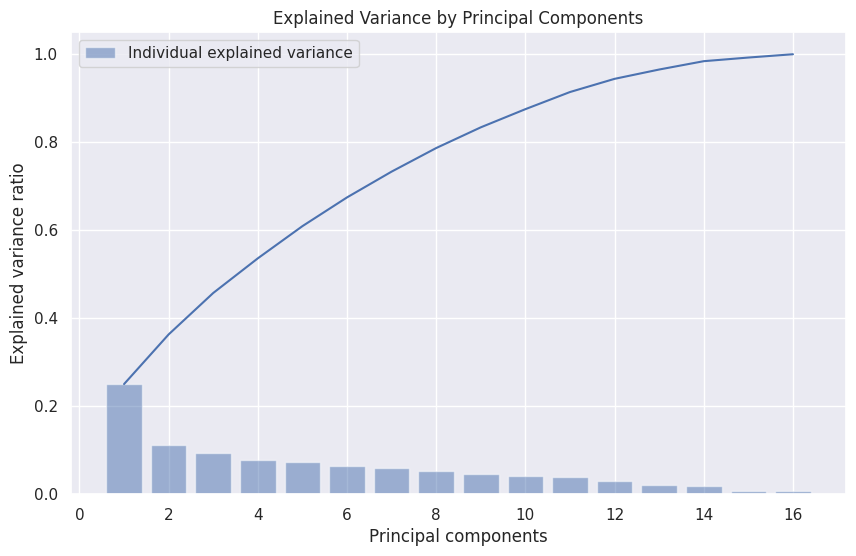

Number of components to capture 95% of the variance: 13


In [28]:
# apply pca to see explained variance ratio
data_scaled = StandardScaler().fit_transform(data.select_dtypes(np.number))
pca=PCA()
pca.fit(data_scaled)
# explained variance ratio
explained_variance = pca.explained_variance_ratio_
cum_explained_variance = np.cumsum(explained_variance)

# Plot the explained variance
plt.figure(figsize=(10, 6))
plt.bar(range(1, len(explained_variance) + 1), explained_variance, alpha=0.5, align='center', label='Individual explained variance')
# plt.step(range(1, len(cum_explained_variance) + 1), cum_explained_variance, where='mid', label='Cumulative explained variance')
plt.plot(range(1,len(cum_explained_variance)+1),cum_explained_variance)
plt.ylabel('Explained variance ratio')
plt.xlabel('Principal components')
plt.legend(loc='best')
plt.title('Explained Variance by Principal Components')
plt.show()

# Determine the number of components to capture 95% of the variance
n_components_95 = np.argmax(cum_explained_variance >= 0.95) + 1
print(f'Number of components to capture 95% of the variance: {n_components_95}')

Turns out components of 13 explaines most variance. Then, visualize the clustered data in 3D.

In [29]:
# pca_tsne_visualization_3d(13,data_clustered)
fig = pca_visualization_3d(13,data_clustered)

# Build Recommendation system
Based on previous results, similar music tend to be close in feature space and clusterd together. These similarities lies in many features like genre, author, style, release time, etc.
We can build a recommendation system based on the idea that music close to the ones in the user's playlist are perfect match with the user's music taste.

In [30]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()),
                                  ('kmeans', KMeans(n_clusters=20,
                                   verbose=False))
                                 ], verbose=False)

data = pd.read_csv('https://raw.githubusercontent.com/junjun2070/pic-16B-final-project/main/data.csv')
X = data.select_dtypes(np.number) # the numeric columns
number_cols = list(X.columns) # the numeric columns of data
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
# data['cluster_label'] = song_cluster_labels

number_cols # show the numeric columns

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



['valence',
 'year',
 'acousticness',
 'danceability',
 'duration_ms',
 'energy',
 'explicit',
 'instrumentalness',
 'key',
 'liveness',
 'loudness',
 'mode',
 'popularity',
 'speechiness',
 'tempo']

Then, define a function of searching one song by it's name and year on spotify and retrieve the features of the song and return a song vector.

Then define the function of geting songs data,the function that calculate the mean vector of the input song vectors, a function that turns a list of dictionary of songs into a single dictionary, and a recommendation fucntion that returns 10 best songs.

In [31]:

number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']


def get_song_data(song, spotify_data):
    """
    Retrieves song data from a provided Spotify dataset based on the provided
    song information.
    """

    try:
        song_data = spotify_data[(spotify_data['name'] == song['name'])
                                & (spotify_data['year'] == song['year'])].iloc[0]
        return song_data

    except IndexError:
        # return find_song(song['name'], song['year']) #use spotify api
        return None

def get_mean_vector(song_list, spotify_data):
    """
    Computes the mean feature vector of a list of songs by fetching their dat
     and averaging their feature vectors.
    """
    song_vectors = []

    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)
        # print(song_vector.shape)

    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)


def flatten_dict_list(dict_list):
    """
    Flattens a list of dictionaries into a single dictionary.
    """

    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []

    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)

    return flattened_dict



In [32]:
class RecommendationSystem:
    def __init__(self, spotify_data):
        """
        Initialize the RecommendationSystem with the dataset.

        Parameters:
        spotify_data (pd.DataFrame): The dataset of songs.
        """
        self.spotify_data = spotify_data

    def recommend_songs(self, song_list, n_songs=10):
        """
        Generate song recommendations based on a list of input songs.

        Parameters:
        song_list (list): A list of dictionaries with metadata for input songs.
        n_songs (int, optional): The number of recommended songs to return. Default is 10.

        Returns:
        list: A list of dictionaries with metadata for recommended songs.
        """
        metadata_cols = ['name', 'year', 'artists']
        # Flattens a list of dictionaries into a single dictionary
        song_dict = flatten_dict_list(song_list)

        song_center = get_mean_vector(song_list, self.spotify_data)
        # standardize the data
        scaler = song_cluster_pipeline.steps[0][1]
        scaled_data = scaler.transform(self.spotify_data[number_cols])
        scaled_song_center = scaler.transform(song_center.reshape(1, -1))
        distances = cdist(scaled_song_center, scaled_data, 'cosine')

        # computing distances between vecotors
        index = list(np.argsort(distances)[:, :n_songs][0])
        rec_songs = self.spotify_data.iloc[index]
        # avoid songs already in input
        rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
        # return a list of songs recommendations
        return rec_songs[metadata_cols].to_dict(orient='records')


Here are the recommended songs based on the input of my favorite songs.

In [33]:
# initialize recommendation system:
recommender = RecommendationSystem(data)
recommendations = recommender.recommend_songs([{'name': 'Needed Me', 'year':2016},
                {'name': 'The Night Is Still Young', 'year': 2014},
                {'name': 'The Other Side Of Paradise', 'year': 2016},
                {'name': 'positions', 'year': 2020},
                {'name': 'Blinding Lights', 'year': 2020}])
recommendations

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning:

X does not have valid feature names, but StandardScaler was fitted with feature names



[{'name': 'Lemonade',
  'year': 2020,
  'artists': "['Internet Money', 'Gunna', 'Don Toliver', 'NAV']"},
 {'name': 'Lemonade (feat. Gunna, Don Toliver & NAV)',
  'year': 2020,
  'artists': "['Internet Money', 'Gunna', 'Don Toliver', 'NAV']"},
 {'name': 'Truth Hurts', 'year': 2019, 'artists': "['Lizzo']"},
 {'name': 'Diva (feat. Lil Tecca)',
  'year': 2020,
  'artists': "['The Kid LAROI', 'Lil Tecca']"},
 {'name': 'Lemonade (feat. Gunna, Don Toliver & NAV)',
  'year': 2020,
  'artists': "['Internet Money', 'Gunna', 'Don Toliver', 'NAV']"},
 {'name': 'Screw Juice', 'year': 2020, 'artists': "['Juice WRLD']"},
 {'name': 'Ashes', 'year': 2020, 'artists': "['Stellar']"},
 {'name': 'Come Thru (with Usher)',
  'year': 2019,
  'artists': "['Summer Walker', 'Usher']"},
 {'name': 'Gifted (feat. Roddy Ricch)',
  'year': 2020,
  'artists': "['Cordae', 'Roddy Ricch']"},
 {'name': 'Cigarettes On Patios', 'year': 2019, 'artists': "['BabyJake']"}]

# link to github
https://github.com/junjun2070/pic-16B-final-project.git